Installation
- https://medium.com/@sourav_raj/ultimate-easiest-way-to-install-geopandas-on-windows-add-to-jupyter-notebook-which-will-a4b11223f4f2
- https://github.com/thomasdubdub/covid-france/blob/master/demo-covid.ipynb

Lignes de commandes (une fois geopandas et contextily installés) /n
conda activate maps_env /n
#python -m ipykernel install --name maps_env (la 1ere fois) /n 
jupyter notebook /n
Puis créer un jupyter notebook dans cet environnement

In [6]:
import numpy as np
from IPython.display import HTML
import requests
import zipfile
import io
from datetime import timedelta, date
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pandas as pd
import geopandas as gpd
import contextily as ctx
from PIL import Image

## Surface cultivée

In [50]:
#IMPORT DES DONNEES DE SURFACE 2010
#output de cette cellule : data_full (toutes cultures) et data (uniquement cultures qui nous intéressent), au niveau canton

#import file, origine : https://agreste.agriculture.gouv.fr/agreste-web/disaron/RA_3013/detail/
data = pd.read_csv("FDS_RA_3013_2010.csv", delimiter=";", low_memory=False)

#clean file
#remove some columns
data = data[["CANTON","CANTON_MOD","RA_3013_DIM2","RA_3013_DIM2_MOD","RA_3013_DIM2_LIB","N118","N118_MOD","N118_LIB","N027","N027_MOD","N027_LIB","VALEUR"]]
#only keep canton level lines
data = data[data.CANTON == "CANTON"]
#remove some columns
data = data[["CANTON_MOD","RA_3013_DIM2_LIB","N118_LIB","N027_LIB","VALEUR"]]
#only keep surface area
data = data[data.N027_LIB == "Superficie concernée"]
#only keep total (all size of farms)
data = data[data.N118_LIB == 'Ensemble des exploitations (hors pacages collectifs)']

#only keep important columns
data = data[["CANTON_MOD","RA_3013_DIM2_LIB","VALEUR"]]

#filter out DOM-TOM which have a canton code of 5 digits
data = data[data.CANTON_MOD.str.len() == 4]

data.rename(columns = {'RA_3013_DIM2_LIB':'Type_de_culture'}, inplace = True)
data.rename(columns = {'VALEUR':'Surface'}, inplace = True)

#select principal culture types
data_full = data[data.Type_de_culture.isin(["Blé tendre", "Blé dur", "Triticale", "Seigle", "Orge et escourgeon", "Avoine", "Maïs-grain et maïs-semence", "Maïs fourrage et ensilage", "Sorgho-Grain", "Soja", "Betterave industrielle", "Tournesol", "Colza", "Pommes de terre et tubercules",
                                           "_ Blé tendre d'hiver et épeautre - 2010","_ Blé tendre de printemps - 2010","_ Blé dur d'hiver - 2010", "_ Blé dur de printemps - 2010","_ Orge d'hiver et escourgeon - 2010","_ Orge de printemps - 2010", "_ Avoine d'hiver - 2010","_ Avoine de printemps - 2010", "_ Colza grain de printemps et navette - 2010","_ Colza grain d'hiver - 2010"  ])]
#data = data[data.Type_de_culture.isin(["Blé tendre", "Blé dur", "Triticale", "Seigle", "Orge et escourgeon", "Avoine", "Maïs-grain et maïs-semence", "Maïs fourrage et ensilage", "Sorgho-Grain", "Soja", "Betterave industrielle", "Tournesol", "Colza", "Pommes de terre et tubercules"])]

In [51]:
#CORRECTION DES DONNEES
#Certaines cultures ont des sous catégories qui ont été mal remplies, il faut donc prendre le maximum entre plusieurs catégories.

data_full["Surface"] = data_full["Surface"].fillna(0) #sinon NaN ne fonctionne pas avec max

pivot = data_full.pivot(index = "CANTON_MOD", columns="Type_de_culture",values = "Surface")

pivot["_Blé tendre"] = pivot["_ Blé tendre d'hiver et épeautre - 2010"] + pivot["_ Blé tendre de printemps - 2010"]
pivot["Blé tendre"] = pivot[["Blé tendre","_Blé tendre"]].max(axis=1)

pivot["_Blé dur"] = pivot["_ Blé dur d'hiver - 2010"] + pivot["_ Blé dur de printemps - 2010"]
pivot["Blé dur"] = pivot[["Blé dur","_Blé dur"]].max(axis=1)

pivot["_Orge et escourgeon"] = pivot["_ Orge d'hiver et escourgeon - 2010"] + pivot["_ Orge de printemps - 2010"]
pivot["Orge et escourgeon"] = pivot[["Orge et escourgeon","_Orge et escourgeon"]].max(axis=1)

pivot["_Avoine"] = pivot["_ Avoine d'hiver - 2010"] + pivot["_ Avoine de printemps - 2010"]
pivot["Avoine"] = pivot[["Avoine","_Avoine"]].max(axis=1)

pivot["_Colza"] = pivot["_ Colza grain de printemps et navette - 2010"] + pivot["_ Colza grain d'hiver - 2010"]
pivot["Colza"] = pivot[["Colza","_Colza"]].max(axis=1)

data = pivot.stack().reset_index(name='Surface')
data = data[data.Type_de_culture.isin(["Blé tendre", "Blé dur", "Triticale", "Seigle", "Orge et escourgeon", "Avoine", "Maïs-grain et maïs-semence", "Maïs fourrage et ensilage", "Sorgho-Grain", "Soja", "Betterave industrielle", "Tournesol", "Colza", "Pommes de terre et tubercules"])]
data

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,CANTON_MOD,Type_de_culture,Surface
0,0101,Blé tendre,727.67
1,0101,Colza,0.00
2,0101,Maïs fourrage et ensilage,0.00
3,0101,Maïs-grain et maïs-semence,1102.50
4,0101,Orge et escourgeon,209.87
...,...,...,...
55856,9596,Maïs-grain et maïs-semence,0.00
55857,9596,Orge et escourgeon,0.00
55858,9596,Pommes de terre et tubercules,15.00
55861,9598,Maïs-grain et maïs-semence,0.00


In [52]:
#IMPORT DES DONNEES DE RENDEMENT
#output : series rend, au niveau départemental

rend_list = []
#lecture de chaque année
for year in range(2000,2010): #choix de la décénie 2000 - 2010, on pourrait faire 2000 - 2019
    rendyear = pd.read_csv("SAA/FDS_DEVELOPPE_"+str(year)+".csv", delimiter=";", low_memory=False)
    rendyear = rendyear[rendyear.FRDOM == "METRO"]
    rendyear = rendyear[['ANNREF', 'REGION', 'DEP', 'N306_MOD', 'N306_LIB', 'N027_LIB', 'VALEUR']]
    #on ne garde que les rendement
    rendyear = rendyear[rendyear.N027_LIB == "Rendement"]
    rendyear = rendyear[rendyear.N306_LIB.isin(["Blé tendre et épeautre", "Blé dur", "Triticale", "Seigle et méteil", "Orge et escourgeon", "Avoine", "Maïs grain et maïs semence", "Sorgho grain", "Soja", "Betterave industrielle", "Tournesol", "Colza grain et navette", "Pommes de terre de consommation"])]
    #les pommes de terre de consommation ont un rendement très proches des pommes de terre. La base de données ne contient pas le rendement des pommes de terre (superficie et prod uniquement), plutot que de calculer le rendement on prend celui de la sous catégorie
    rendyear.rename(columns = {'VALEUR':'Rendement'}, inplace = True)
    rendyear.rename(columns = {'N306_LIB':'Type_de_culture'}, inplace = True)
    rendyear = rendyear[['REGION', 'DEP',  'Type_de_culture', 'ANNREF', 'Rendement']]
    rend_list.append(rendyear)

#concaténation des fichiers
rend = pd.concat(rend_list)

#calcul du rendement moyen
rend = rend.groupby(["DEP","Type_de_culture"]).mean()
#rend = rend[["REGION","DEP","Type_de_culture","Rendement"]]
rend = rend["Rendement"]
rend

DEP  Type_de_culture                
...  Avoine                              42.956429
     Betterave industrielle             780.628889
     Blé dur                             51.750794
     Blé tendre et épeautre              64.252143
     Colza grain et navette              30.790000
                                           ...    
95   Pommes de terre de consommation    353.380000
     Seigle et méteil                    60.888889
     Sorgho grain                        52.000000
     Tournesol                           25.200000
     Triticale                           63.400000
Name: Rendement, Length: 1095, dtype: float64

In [53]:
#CROISEMMENT DES SURFACES ET DES RENDEMENTS
#Output : data avec une nouvelle colonne rendement

#les noms des céréales sont différents dans les 2 fichiers
dico = {"Blé tendre":"Blé tendre et épeautre", 
        "Blé dur":"Blé dur", 
        "Triticale":"Triticale", 
        "Seigle":"Seigle et méteil",
        "Orge et escourgeon":"Orge et escourgeon", 
        "Avoine":"Avoine", 
        "Maïs-grain et maïs-semence":"Maïs grain et maïs semence", 
        "Maïs fourrage et ensilage":"Maïs grain et maïs semence", #très mauvaise hypothèse mais pas très grave, puisqu'il y a très peu de résidu de culture associé. Pour améliorer, aller chercher les données ici : https://agreste.agriculture.gouv.fr/agreste-web/disaron/SAANR_FOURRAGE_2/detail/
        "Sorgho-Grain":"Sorgho grain", 
        "Soja":"Soja", 
        "Betterave industrielle":"Betterave industrielle", 
        "Tournesol":"Tournesol", 
        "Colza":"Colza grain et navette",
        "Pommes de terre et tubercules":"Pommes de terre de consommation"  
       }

data["Rendement"] = 0.0
for index in data.index.values:
    dep = data.at[index,"CANTON_MOD"][0:2]
    culture = data.at[index,"Type_de_culture"]
    try:
        data.at[index,"Rendement"] = rend[dep][dico[culture]]
    except:
        #print("Warning index "+str(index))
        #alors on prend la valeur nationale
        data.at[index,"Rendement"] = rend["..."][dico[culture]]
data

,CANTON_MOD,Type_de_culture,Surface,Rendement
0,0101,Blé tendre,727.67,67.47
1,0101,Colza,0.00,30.10
2,0101,Maïs fourrage et ensilage,0.00,88.79
3,0101,Maïs-grain et maïs-semence,1102.50,88.79
4,0101,Orge et escourgeon,209.87,59.94
...,...,...,...,...
55856,9596,Maïs-grain et maïs-semence,0.00,89.56
55857,9596,Orge et escourgeon,0.00,69.49
55858,9596,Pommes de terre et tubercules,15.00,353.38
55861,9598,Maïs-grain et maïs-semence,0.00,89.56


In [54]:
#calcul de production
#output : data avec une nouvelle colonne production en tonnes

data["Production"] = 0.0
for index in data.index.values:
    data.at[index,"Production"] = data.at[index,"Surface"]*data.at[index,"Rendement"]/10 #on passe en tonnes
data

,CANTON_MOD,Type_de_culture,Surface,Rendement,Production
0,0101,Blé tendre,727.67,67.47,4909.58949
1,0101,Colza,0.00,30.10,0.00000
2,0101,Maïs fourrage et ensilage,0.00,88.79,0.00000
3,0101,Maïs-grain et maïs-semence,1102.50,88.79,9789.09750
4,0101,Orge et escourgeon,209.87,59.94,1257.96078
...,...,...,...,...,...
55856,9596,Maïs-grain et maïs-semence,0.00,89.56,0.00000
55857,9596,Orge et escourgeon,0.00,69.49,0.00000
55858,9596,Pommes de terre et tubercules,15.00,353.38,530.07000
55861,9598,Maïs-grain et maïs-semence,0.00,89.56,0.00000


## Résidus de culture

In [55]:
#CALCUL DES RESIDUS DE CULTURE A PARTIR DU FICHIER EXCEL

#rapport entre prod de résidu et production utile
rapport_2010 = {"Blé tendre":0.885, 
        "Blé dur":1.082, 
        "Triticale":1.082, 
        "Seigle":0.85,
        "Orge et escourgeon":0.85, 
        "Avoine": 1.127, 
        "Maïs-grain et maïs-semence":0.885, 
        "Maïs fourrage et ensilage":0.111, 
        "Sorgho-Grain": 1.174, 
        "Soja": 1.806, 
        "Betterave industrielle": 0.1 , 
        "Tournesol": 1.726, 
        "Colza": 2.081,
        "Pommes de terre et tubercules": 0.075  
       }

data["Résidu_de_culture"] = 0.0
for index in data.index.values:
    culture = data.at[index,"Type_de_culture"]
    data.at[index,"Résidu_de_culture"] = data.at[index,"Production"] * rapport_2010[data.at[index,"Type_de_culture"]]
data

,CANTON_MOD,Type_de_culture,Surface,Rendement,Production,Résidu_de_culture
0,0101,Blé tendre,727.67,67.47,4909.58949,4344.986699
1,0101,Colza,0.00,30.10,0.00000,0.000000
2,0101,Maïs fourrage et ensilage,0.00,88.79,0.00000,0.000000
3,0101,Maïs-grain et maïs-semence,1102.50,88.79,9789.09750,8663.351287
4,0101,Orge et escourgeon,209.87,59.94,1257.96078,1069.266663
...,...,...,...,...,...,...
55856,9596,Maïs-grain et maïs-semence,0.00,89.56,0.00000,0.000000
55857,9596,Orge et escourgeon,0.00,69.49,0.00000,0.000000
55858,9596,Pommes de terre et tubercules,15.00,353.38,530.07000,39.755250
55861,9598,Maïs-grain et maïs-semence,0.00,89.56,0.00000,0.000000


In [57]:
#gisement de résidus de culture
#comme l'ADEME, on fait l'hypothèse d'une récupération de 20%
data["Gisement_résidu"] = data["Résidu_de_culture"]*0.2
data

,CANTON_MOD,Type_de_culture,Surface,Rendement,Production,Résidu_de_culture,Gisement_résidu
0,0101,Blé tendre,727.67,67.47,4909.58949,4344.986699,868.997340
1,0101,Colza,0.00,30.10,0.00000,0.000000,0.000000
2,0101,Maïs fourrage et ensilage,0.00,88.79,0.00000,0.000000,0.000000
3,0101,Maïs-grain et maïs-semence,1102.50,88.79,9789.09750,8663.351287,1732.670257
4,0101,Orge et escourgeon,209.87,59.94,1257.96078,1069.266663,213.853333
...,...,...,...,...,...,...,...
55856,9596,Maïs-grain et maïs-semence,0.00,89.56,0.00000,0.000000,0.000000
55857,9596,Orge et escourgeon,0.00,69.49,0.00000,0.000000,0.000000
55858,9596,Pommes de terre et tubercules,15.00,353.38,530.07000,39.755250,7.951050
55861,9598,Maïs-grain et maïs-semence,0.00,89.56,0.00000,0.000000,0.000000


In [64]:
#VISUALISATION AU NIVEAU NATIONAL

national = data.groupby(["Type_de_culture"]).sum()
national = national[["Surface","Production","Résidu_de_culture"]]
national = national.sort_values(by="Résidu_de_culture", ascending=False)
national["Rendement"] = national["Production"]/national["Surface"]
national
# la surface est en hectare, la production est en tonnes.

,Surface,Production,Résidu_de_culture,Rendement
Type_de_culture,,,,
Blé tendre,4871875.56,3.469349e+07,3.070374e+07,7.121177
Maïs-grain et maïs-semence,1581507.58,1.378281e+07,1.219779e+07,8.714985
Colza,1273010.43,4.126493e+06,8.587231e+06,3.241523
Orge et escourgeon,1544248.97,9.710593e+06,8.254004e+06,6.288230
Blé dur,474174.34,2.372481e+06,2.567024e+06,5.003393
Betterave industrielle,315479.02,2.521125e+07,2.521125e+06,79.914196
Tournesol,614499.56,1.451609e+06,2.505477e+06,2.362262
Triticale,365253.84,1.861702e+06,2.014361e+06,5.097008
Maïs fourrage et ensilage,1258452.42,1.045588e+07,1.160603e+06,8.308524


## CIVE

In [58]:
#CIVE = CIMSE
#les résultats sont plus élevés ici que dans l'étude car nous n'avons pas pris en compte la baisse des rendements due au changement climatique et au passage en agriculture biologique. Les surfaces sont aussi celles de 2010, ce qui compense en partie.

#en 2050
cive_ete = ["Colza","Blé dur", "Blé tendre", "Orge et escourgeon", "Triticale","Avoine","Seigle"]
cive_hiver = ["Tournesol", "Maïs fourrage et ensilage", "Maïs-grain et maïs-semence", "Betterave industrielle", "Pommes de terre et tubercules", "Sorgho-Grain","Soja"]

#creation of df with surfaces
databis = data[["CANTON_MOD","Type_de_culture","Surface"]]
pivot = databis.pivot(index = "CANTON_MOD", columns="Type_de_culture",values = "Surface")
pivot = pivot.fillna(0)
pivot["cive_ete"] = 0.
pivot["cive_hiver"] = 0.
for culture in cive_ete:
    pivot["cive_ete"] += pivot[culture]
for culture in cive_hiver:
    pivot["cive_hiver"] += pivot[culture]
data_civ = pivot.stack().reset_index(name='Surface')
data_civ = data_civ[data_civ.Type_de_culture.isin(["cive_ete","cive_hiver"])]


#détermination des rendements des CIVE
#source de la répartition des départements: figure 107, étude 100% renouvelable ADEME
bon_ete = [29,22,56,35,50,14,27,76,62,59,80,60,"02",28,45,78,91,77,95,92,93,94]
mediocre_ete = [33,24,40,47,64,12,46,81,82,31,32,"09",65,66,11,34,30,48,"07",26,13,83,84,"04","05","06","2A","2B"]
bon_hiver = [29,22,56,35,50,14,27,76,62,80,60,28,45,78,91,77,95,92,93,94 ,61,53,72,44,49,85,18,36,37,41,79,86,16,17]
mediocre_hiver = [12,46,"09",65,66,11,34,30,48,"07",26,13,83,84,"04","05","06","2A","2B", 15,42,43,73,74,39,25,90]

bon_ete = (list(map(str,bon_ete)))
mediocre_ete = (list(map(str,mediocre_ete)))
bon_hiver = (list(map(str,bon_hiver)))
mediocre_hiver = (list(map(str,mediocre_hiver)))

list_dep = ["01", "02", "03", "04","05","06","07","08","09","2A","2B"]
list_dep += list(map(str,list(range(10,96))))
list_dep.remove("20")
list_dep.remove("75")

#valeurs de rendements : source tableau 54 de l'étude ADEME. Cela prend en compte un cut off à 4t/ha.
#ces rendements sont en tonnes de matières sèches par ha.
culture_to_cive = pd.DataFrame(np.array([list_dep]))
culture_to_cive = culture_to_cive.transpose()
culture_to_cive.rename(columns = {0:'DEP'}, inplace = True)
culture_to_cive = culture_to_cive.set_index('DEP')
culture_to_cive["cive_ete"] = 0.4
culture_to_cive["cive_hiver"] = 3.0
for e in bon_ete:
    culture_to_cive.at[e,"cive_ete"] = 2.7
for e in mediocre_ete:
    culture_to_cive.at[e,"cive_ete"] = 0
for e in bon_hiver:
    culture_to_cive.at[e,"cive_hiver"] = 4.9
for e in mediocre_hiver:
    culture_to_cive.at[e,"cive_hiver"] = 1.3

#ajout des rendements dans data_civ
data_civ["Rendement"] = 0.0
for index in data_civ.index.values:
    dep = data_civ.at[index,"CANTON_MOD"][0:2]
    culture = data_civ.at[index,"Type_de_culture"]
    data_civ.at[index,"Rendement"] = culture_to_cive.at[dep,culture]

#calcul de la production
data_civ["Production"] = data_civ["Surface"] * data_civ["Rendement"]
data_civ

,CANTON_MOD,Type_de_culture,Surface,Rendement,Production
14,0101,cive_ete,937.54,0.4,375.016
15,0101,cive_hiver,1479.12,3.0,4437.360
30,0102,cive_ete,1024.22,0.4,409.688
31,0102,cive_hiver,1975.49,3.0,5926.470
46,0103,cive_ete,297.85,0.4,119.140
...,...,...,...,...,...
55119,9596,cive_hiver,15.00,4.9,73.500
55134,9598,cive_ete,0.00,2.7,0.000
55135,9598,cive_hiver,0.00,4.9,0.000
55150,9599,cive_ete,0.00,2.7,0.000


In [59]:
civ_national = data_civ.groupby("Type_de_culture").sum()
civ_national["Rendement"] = civ_national["Production"]/civ_national["Surface"]
civ_national

,Surface,Rendement,Production
Type_de_culture,,,
cive_ete,8611201.42,1.158612,9.977039e+06
cive_hiver,3965823.65,3.900080,1.546703e+07


4.861063868999585


[Text(0.5, 0, 'rendement (tMS/ha)'), Text(0, 0.5, 'Production (t)')]

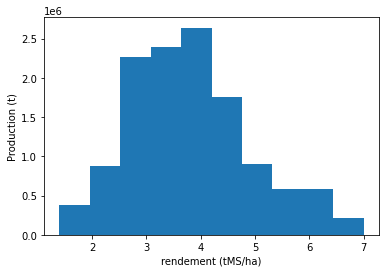

In [62]:
#étude de sensibilité
sensi = data_civ.groupby(["Type_de_culture","Rendement"], as_index = False).sum()
sensi

#tableau 54
rend_hiver = [6,5.4,5,4.7,4.4,4.1,3.8,3.4,3.1,2.8]
rend_ete = [4,3.7,3.5,3.4,3.2,3,2.9,2.7,2.6,2.4]

yields={}

ete_mediocre = sensi.at[0,"Surface"]
ete_moyen = sensi.at[1,"Surface"]
ete_bon = sensi.at[2,"Surface"]
hiver_mediocre = sensi.at[3,"Surface"]
hiver_moyen = sensi.at[4,"Surface"]
hiver_bon = sensi.at[5,"Surface"]

for y in rend_hiver:
    try:
        yields[y] += hiver_moyen/10
    except:
        yields[y] = hiver_moyen/10
    try:
        yields[y+1] += hiver_bon/10
    except:
        yields[y+1] = hiver_bon/10
    try:
        yields[y-1] += hiver_mediocre/10
    except:
        yields[y-1] = hiver_mediocre/10
        
for y in rend_ete:
    try:
        yields[y] += ete_moyen/10
    except:
        yields[y] = ete_moyen/10
    try:
        yields[y+1] += ete_bon/10
    except:
        yields[y+1] = ete_bon/10
    try:
        yields[y-1] += ete_mediocre/10
    except:
        yields[y-1] = ete_mediocre/10
yields

values = []
surface = []
for key in yields:
    values.append(key)
    surface.append(yields[key])

cutoff = 4
def cut(a, cutoff):
    if a>= cutoff:
        return a
    else:
        return 0

factor = [0.9+x/100 for x in range(21)]
prod=[]
for f in factor:
    prod.append(sum(cut(values[g]*f,cutoff) * surface[g] for g in range(len(yields))))

values2 = []
surface2 = []
for key in yields:
    if key>= cutoff:
        values2.append(key)
        surface2.append(yields[key])

print(np.average(values2, weights=surface2))
#plt.plot(factor,prod)
fig, ax = plt.subplots()
plt.hist(values, weights = surface)
ax.set(xlabel='rendement (tMS/ha)', ylabel='Production (t)')



(array([1579938.804, 3925203.467, 3378541.292, 1974837.068, 1145939.687,
         110326.75 ,  175955.626,  110326.75 ,   87977.813,   87977.813]),
 array([17.14285714, 24.        , 30.85714286, 37.71428571, 44.57142857,
        51.42857143, 58.28571429, 65.14285714, 72.        , 78.85714286,
        85.71428571]),
 <BarContainer object of 10 artists>)

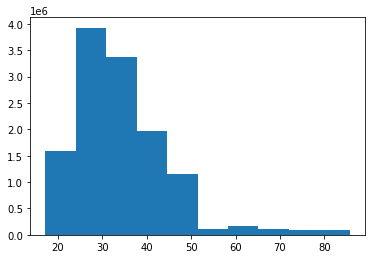

In [157]:
#OPEX de 25 € par tonne de CIVE.
#On suppose un prix fixe à l'ha.
#rendement moyen de 4.86
#soit un cout de 120€ par ha.
#Le cout à la tonne vaut 120€ / rendement.
cout = []
for e in values:
    cout.append(120/e)
plt.hist(cout, weights = surface)

## Elevage

In [4]:
#test avec vache laitière
excretion = 1.95 #tMS/place/an
coef_paille = 0.6 #% MS ???
taux_paturage = 0.3
litiere = 1.5 #tMS/place/an
nb_vache = 10000000

dej = nb_vache * excretion * (1 + coef_paille) * (1-taux_paturage)
print(dej)
besoin_paille = nb_vache * litiere * (1-taux_paturage)
print(besoin_paille)

pouvoir_meth_paille = 220 #m3CH4/tMS
pouvoir_meth_vache = 170 #lisier, m3CH4/tMS



21840000.0
10500000.0


In [47]:
#cas général

df = pd.DataFrame(np.array([["Vache laitière" ,"Vache allaitante", "Autre bovin", "Porc", "Ovin_caprin", "volaille"]]).transpose(),

                   columns=['animal'])
df["nombre_2010"] = [3720000,4136000,11650000,14000000,9200000,185000000]
df["excretion"] = [1.95, 1.61, 0.87, 0.076, 0.15, 0.012] #tableau 60
df["paille_dans_fumier"] = [0.6, 1.1, 0.8, 1.1, 1.1, 1.1] #tableau 60
df["part_fumier"] = [0.9,0.9,0.9,0.1,0,0] #a la louche
df["paturage"] = [0.4,0.8,0.6,0,0,0] #a la louche
df["besoin_paille"] = [1.5, 1.5, 1, 1,1,0] #tableau 61 + interprétation
df["rotation"] = [1,1,1,2,1,8] #nombre d'animaux par place et par an
df["fumier"] = df["nombre_2010"]/df["rotation"]*df["excretion"]*(1+df["paille_dans_fumier"])*(1-df["paturage"])*df["part_fumier"]
df["lisier"] = df["nombre_2010"]/df["rotation"]*df["excretion"]*(1-df["paturage"])*(1-df["part_fumier"])
df["paille"] = df["nombre_2010"]/df["rotation"] * df["part_fumier"] * df["besoin_paille"] * (1-df["paturage"])
df["pouvoir_meth_fumier"] = [168,168,168,192,192,240]
df["pouvoir_meth_lisier"] = [160,160,160,230,150,240] #tableau 62, inventé pour ovin
df["energie"] = (df["fumier"]*df["pouvoir_meth_fumier"]+df["lisier"]*df["pouvoir_meth_lisier"])*11/1000/1000/1000 #en TWh PCS
df
df["energie_perdue"] = df["paille"]*220*11/1000/1000/1000 #energie obtenue en méthanisant la paille de fumier
#conclusion : tout est dans les vaches
# grande incertitude sur le paturage, sur la part fumier, sur les besoin en paille.
df


,animal,nombre_2010,excretion,paille_dans_fumier,part_fumier,paturage,besoin_paille,rotation,fumier,lisier,paille,pouvoir_meth_fumier,pouvoir_meth_lisier,energie,energie_perdue
0,Vache laitière,3720000,1.950,0.6,0.9,0.4,1.5,1,6267456.00,435240.0,3013200.0,168,160,12.348281,7.291944
1,Vache allaitante,4136000,1.610,1.1,0.9,0.8,1.5,1,2517086.88,133179.2,1116720.0,168,160,4.885972,2.702462
2,Autre bovin,11650000,0.870,0.8,0.9,0.6,1.0,1,6567804.00,405420.0,4194000.0,168,160,12.850841,10.149480
3,Porc,14000000,0.076,1.1,0.1,0.0,1.0,2,111720.00,478800.0,700000.0,192,230,1.447317,1.694000
4,Ovin_caprin,9200000,0.150,1.1,0.0,0.0,1.0,1,0.00,1380000.0,0.0,192,150,2.277000,0.000000
5,volaille,185000000,0.012,1.1,0.0,0.0,0.0,8,0.00,277500.0,0.0,240,240,0.732600,0.000000


# Visualisation

In [8]:
#Copy code from https://github.com/thomasdubdub/covid-france/blob/master/demo-covid.ipynb

#variables declaration
url_dep = "http://osm13.openstreetmap.fr/~cquest/openfla/export/departements-20140306-5m-shp.zip"
filter_dep = ["971", "972", "973", "974", "976"]  # only metropolitan France
figsize = (15, 15)
tile_zoom = 7

#load departements data
local_path = "tmp/"
r = requests.get(url_dep)
z = zipfile.ZipFile(io.BytesIO(r.content))
z.extractall(path=local_path)
filenames = [
    y
    for y in sorted(z.namelist())
    for ending in ["dbf", "prj", "shp", "shx"]
    if y.endswith(ending)
]
dbf, prj, shp, shx = [filename for filename in filenames]
fr = gpd.read_file(local_path + shp)  #  + encoding="utf-8" if needed
fr.crs = "epsg:4326"  # {'init': 'epsg:4326'}
met = fr.query("code_insee not in @filter_dep")
met.set_index("code_insee", inplace=True)
met = met["geometry"]

#load map tile
w, s, e, n = met.total_bounds
bck, ext = ctx.bounds2img(w, s, e, n, zoom=tile_zoom, ll=True)

In [42]:
# How to draw an image
def make_img(df, title, img_name, vmin, vmax, value, save=True):
    #df dataframe, must have a column "geometry" set up with the right data
    #title of graph, img_name is for saving, vmin vmax are min and max of values
    #value is the name of the column of the df to be shown
    #save (default value true) saves the image, else it is only shown.
    #what takes time is to load the background
    gdf = gpd.GeoDataFrame(df, crs={"init": "epsg:4326"})
    gdf_3857 = gdf.to_crs(epsg=3857)  # web mercator
    f, ax = plt.subplots(figsize=figsize)
    ax.imshow(
        bck, extent=ext, interpolation="sinc", aspect="equal"
    )  # load background map
    divider = make_axes_locatable(ax)
    cax = divider.append_axes(
        "right", size="5%", pad=0.1
    )  # GeoPandas trick to adjust the legend bar
    gdf_3857.plot(
        column= value, 
        ax=ax,
        cax=cax,
        alpha=0.75,
        edgecolor="k",
        legend=True,
        cmap=matplotlib.cm.get_cmap("viridis"),
        vmin=vmin,
        vmax=vmax,
    )
   
    #ax.set_axis_off()
    #ax.get_xaxis().set_visible(False)
    #ax.get_yaxis().set_visible(False)
    ax.set_title(title, fontsize=25)
    
    if(save):
        plt.savefig(img_name, bbox_inches="tight")  # pad_inches=-0.1 to remove border  
    
    plt.show()
    plt.close(f)

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


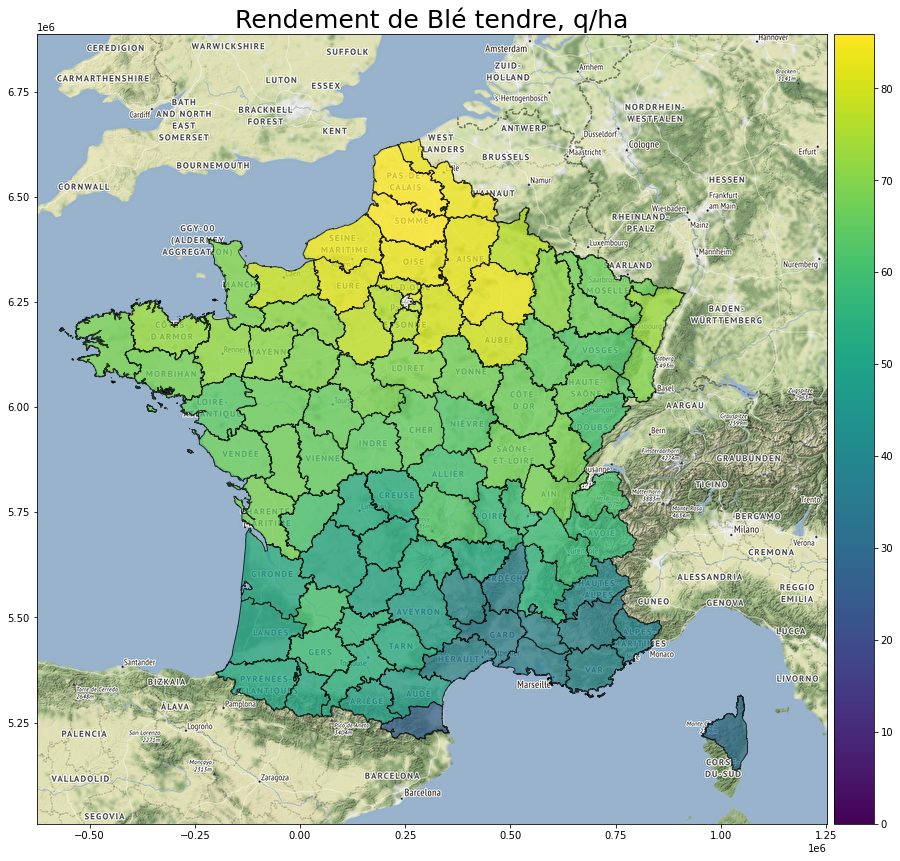

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


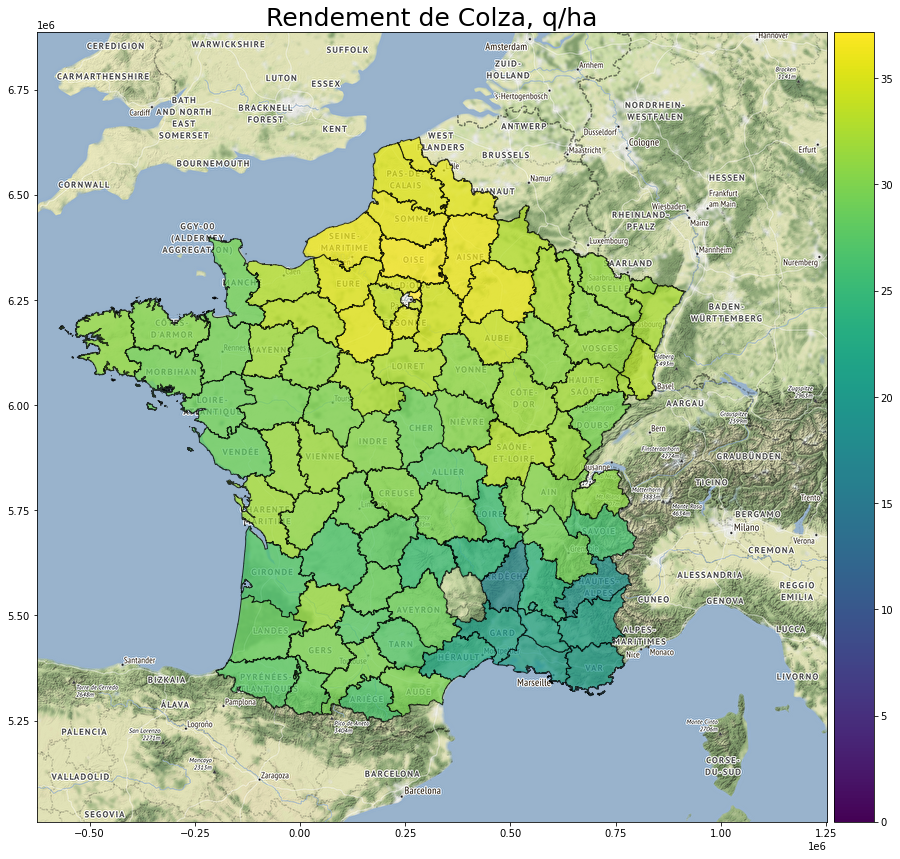

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


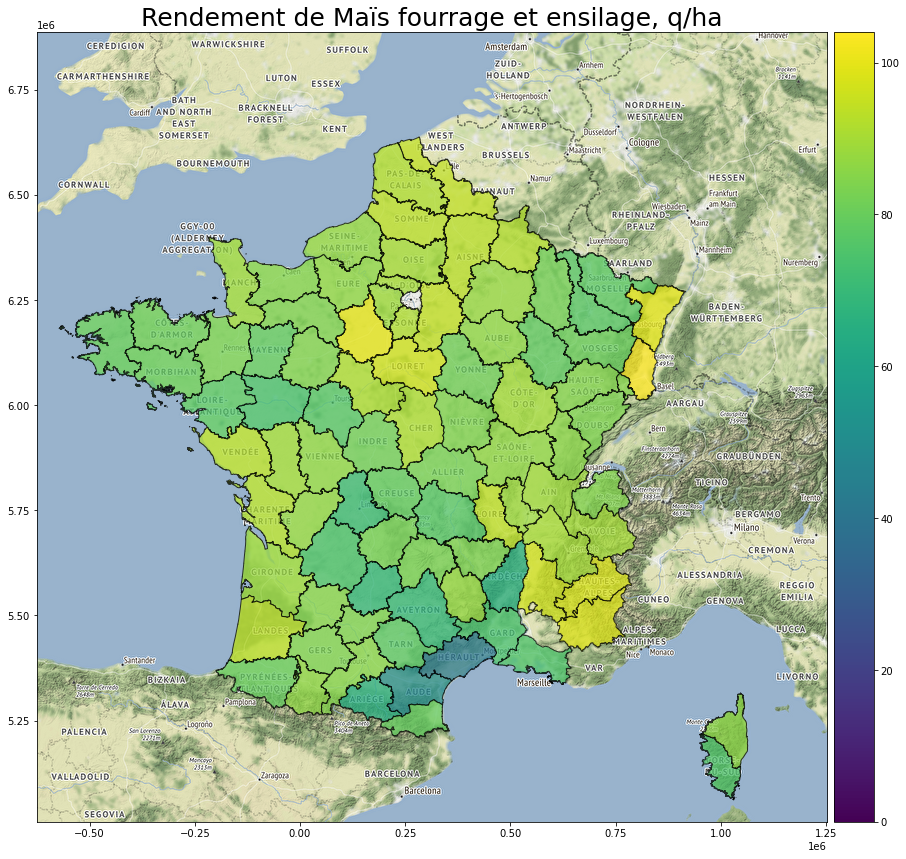

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


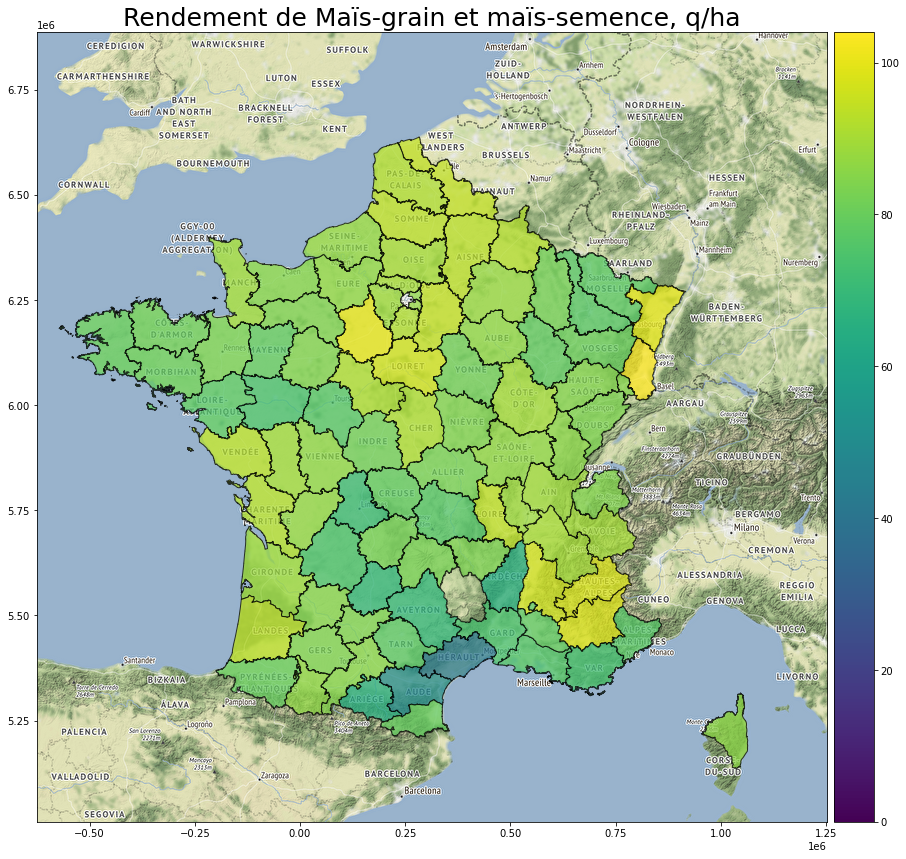

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


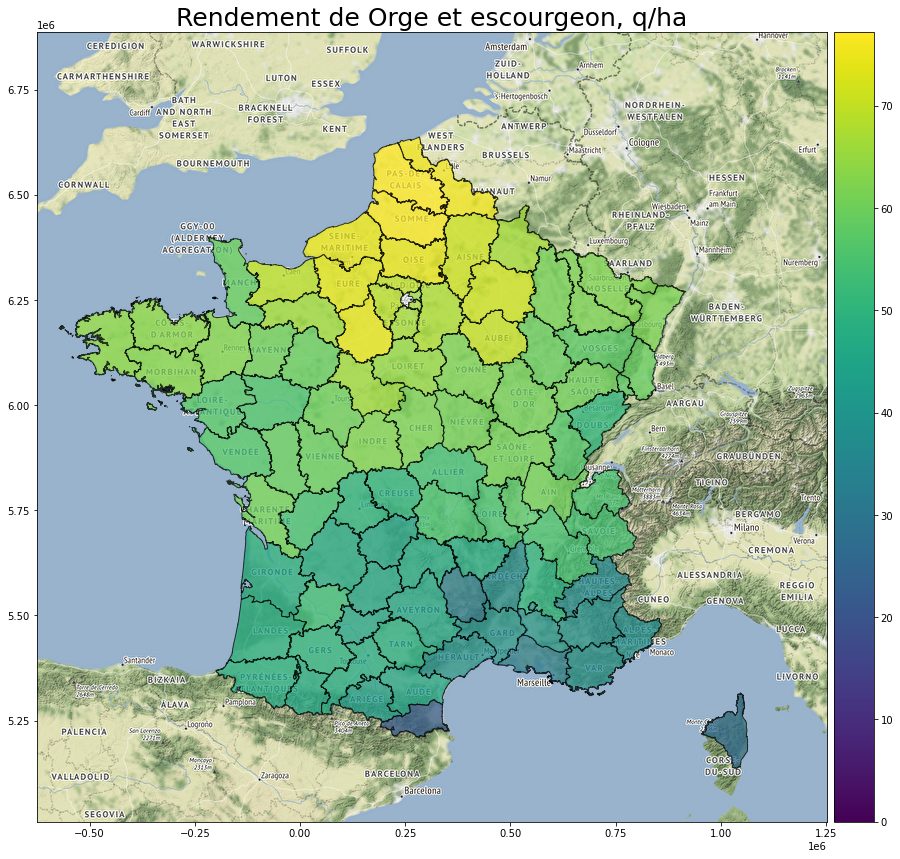

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


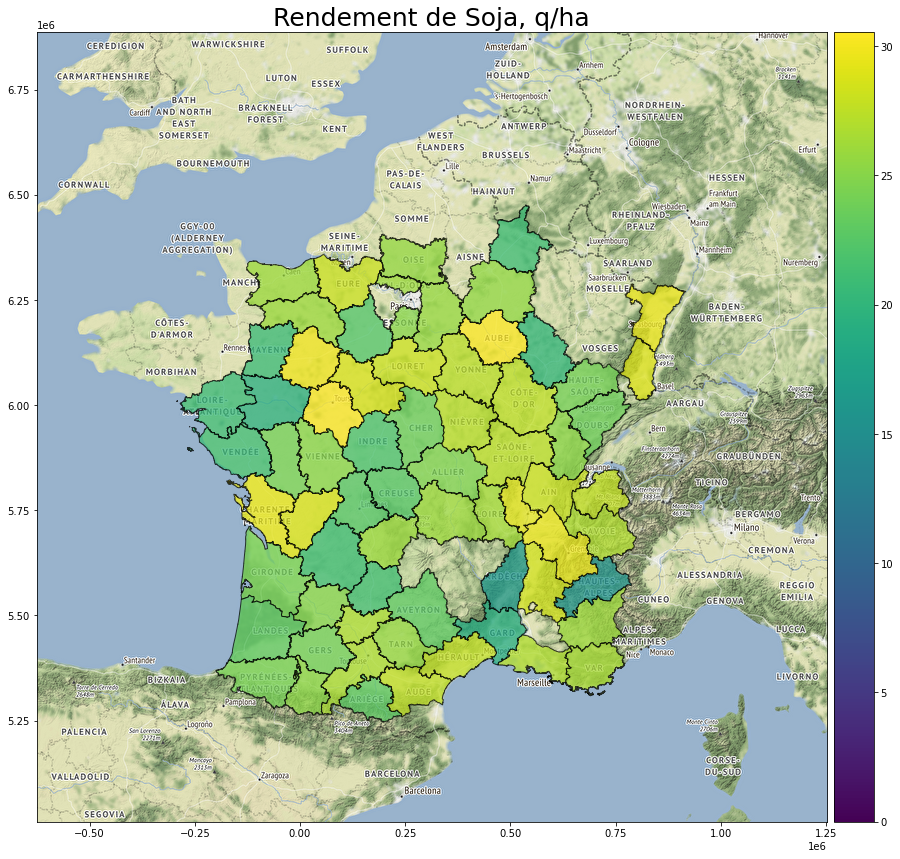

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


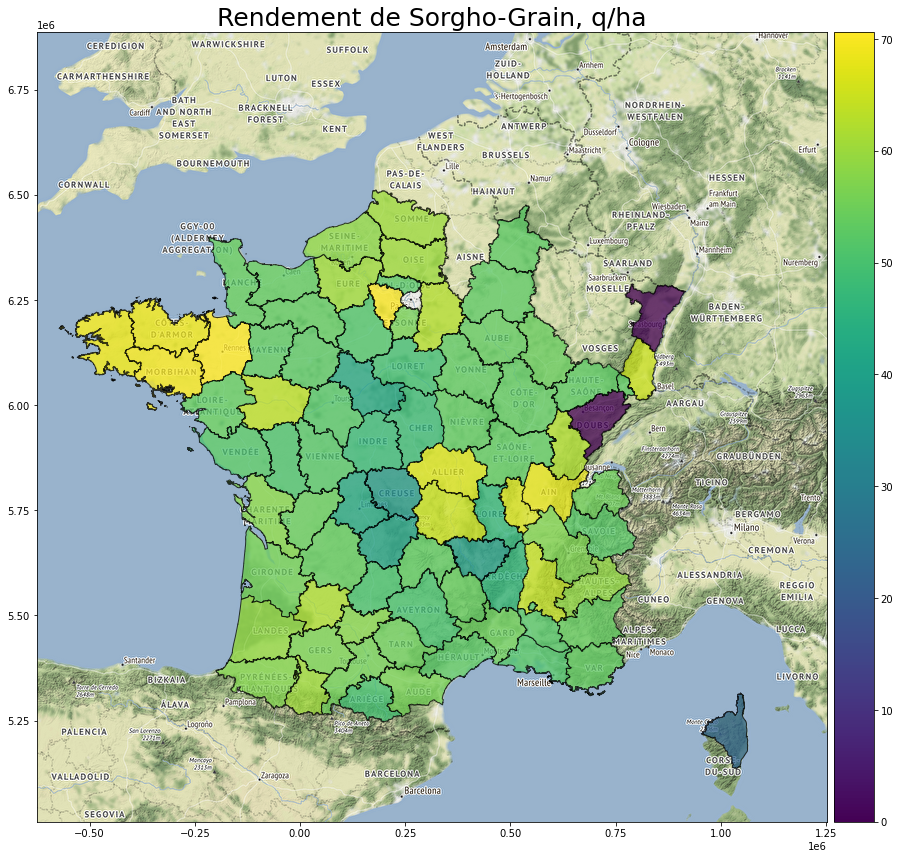

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


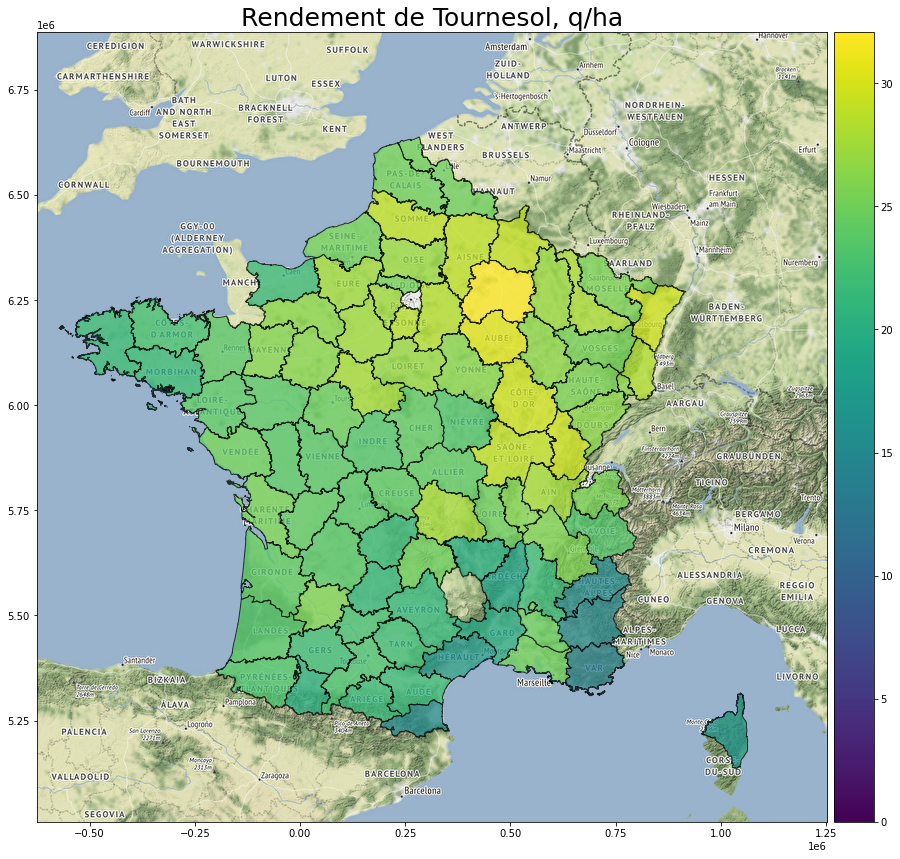

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


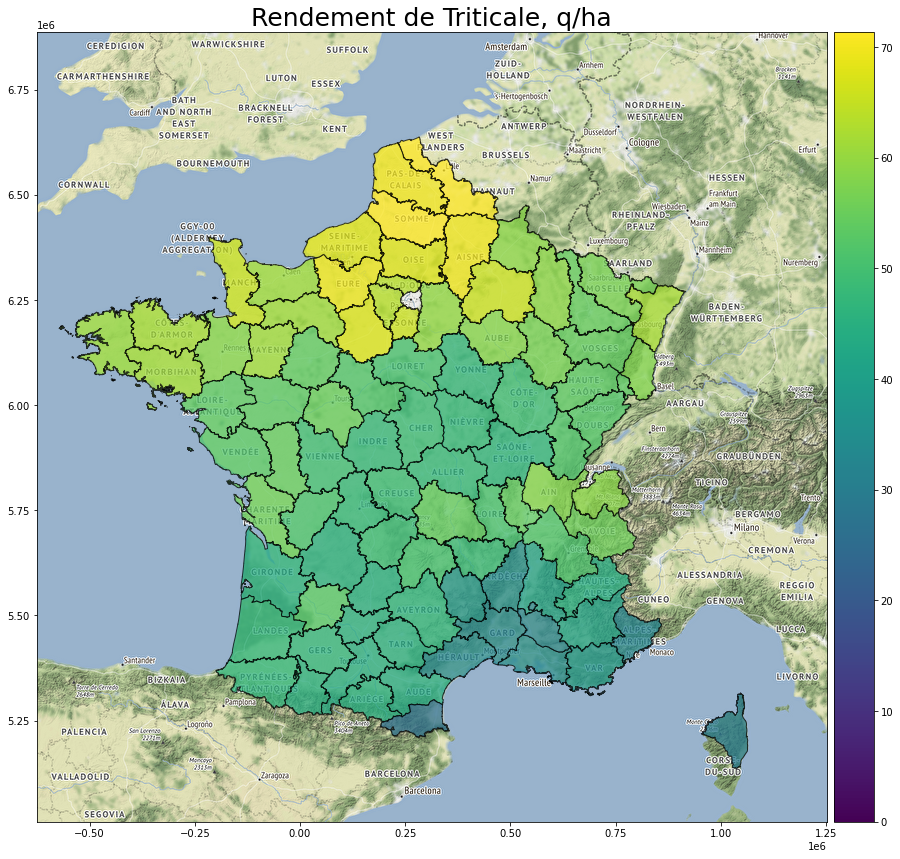

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


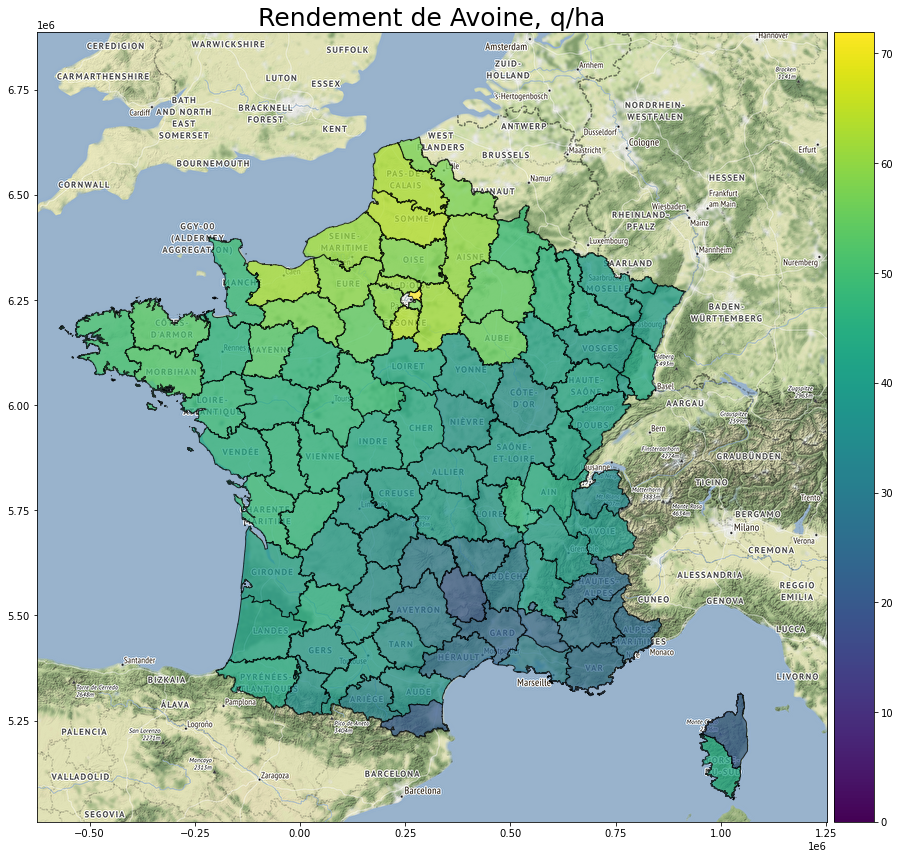

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


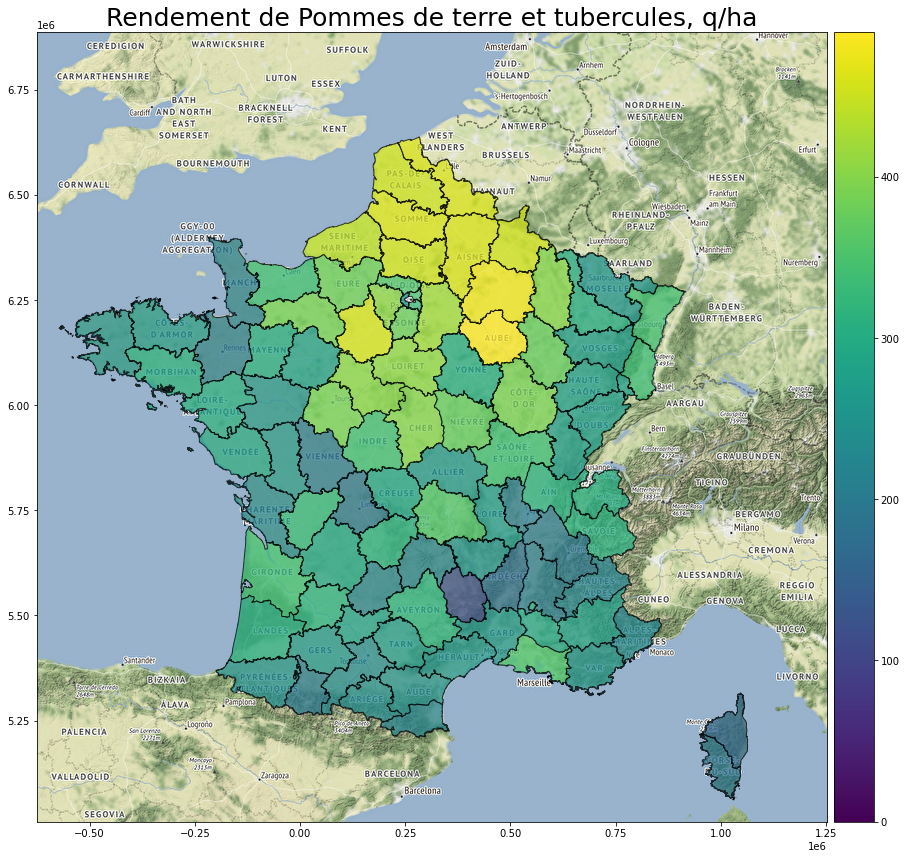

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


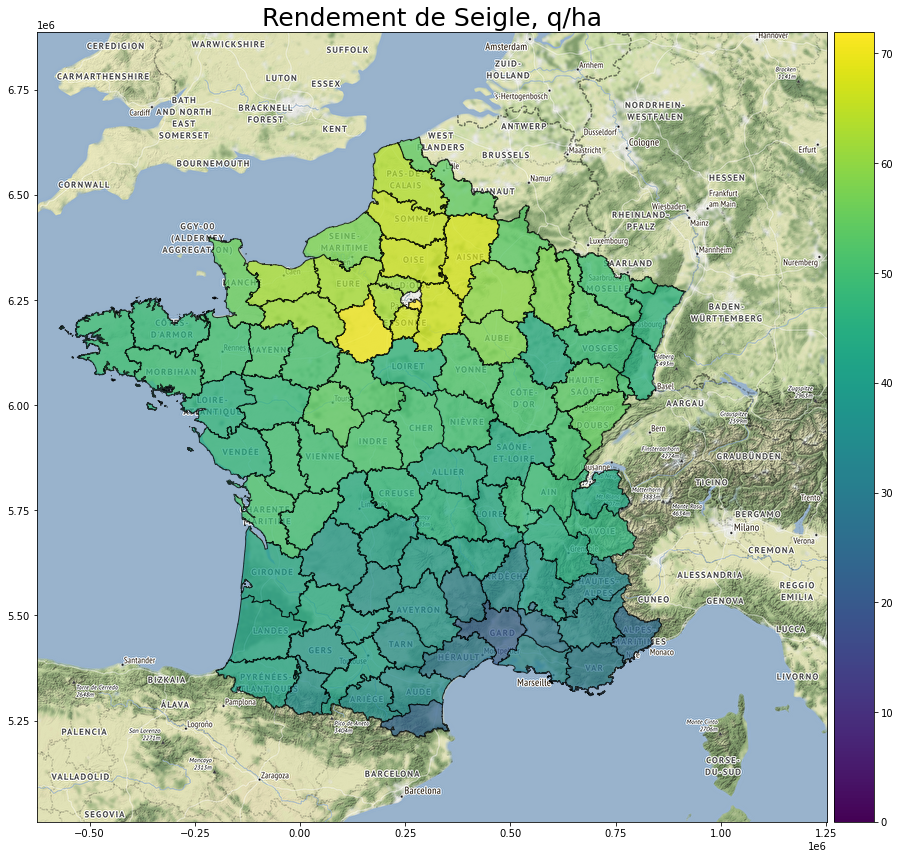

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


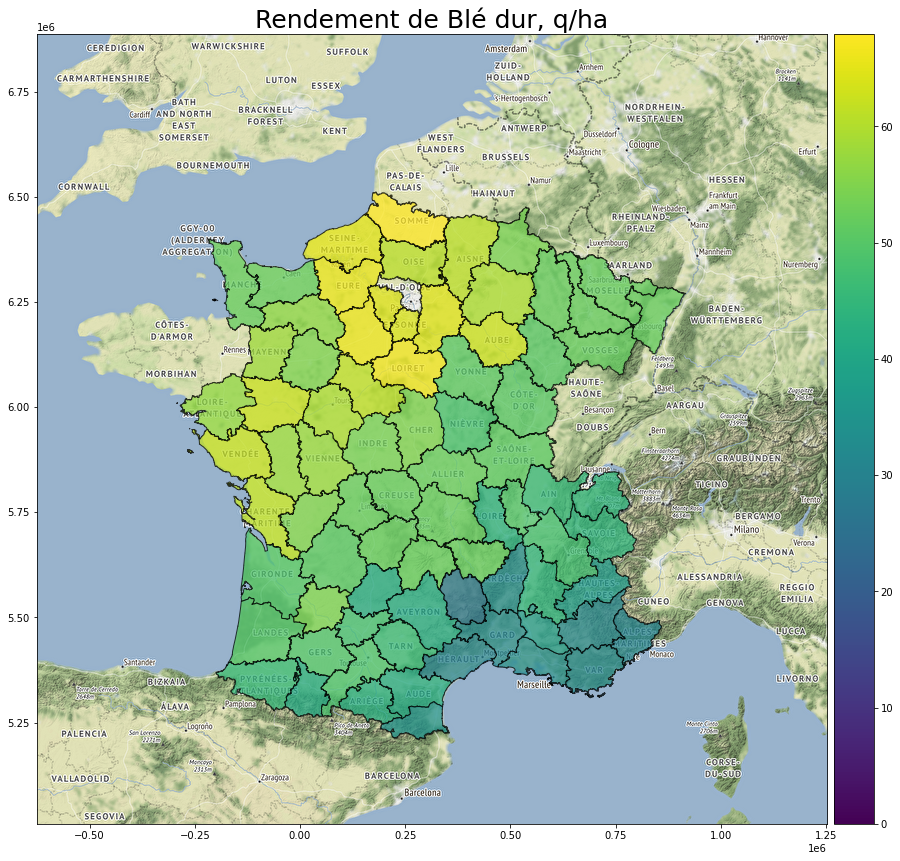

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


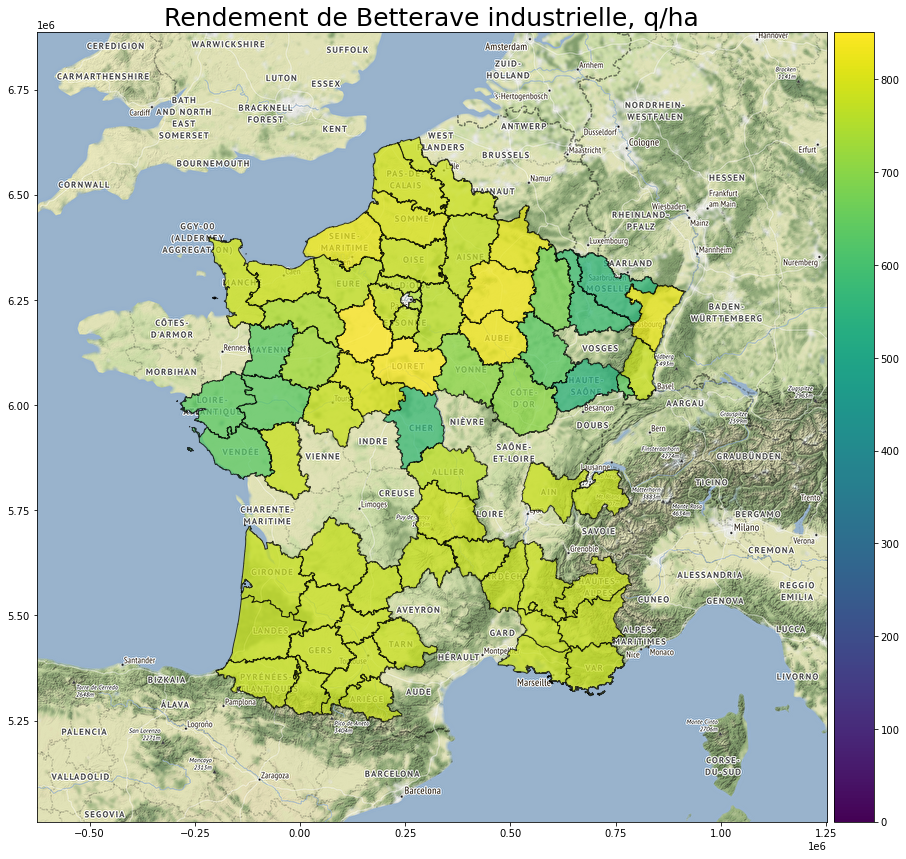

In [44]:
#IMAGE DES RENDEMENTS
for culture in data.Type_de_culture.unique():
    df = data[data.Type_de_culture == culture][["CANTON_MOD","Rendement"]]
    df["DEP"] = ""
    for index in df.index.values:
        df.at[index,"DEP"] = df.at[index,"CANTON_MOD"][0:2]
    df = df.groupby(["DEP"],as_index = False).mean()
    df["geometry"]=df["DEP"].map(met)
    vmax = df.Rendement.max()
    title = "Rendement de "+culture+", q/ha"
    img_name = "rendement_"+culture+".png"
    make_img(df, title, img_name, 0, vmax, "Rendement", True)

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


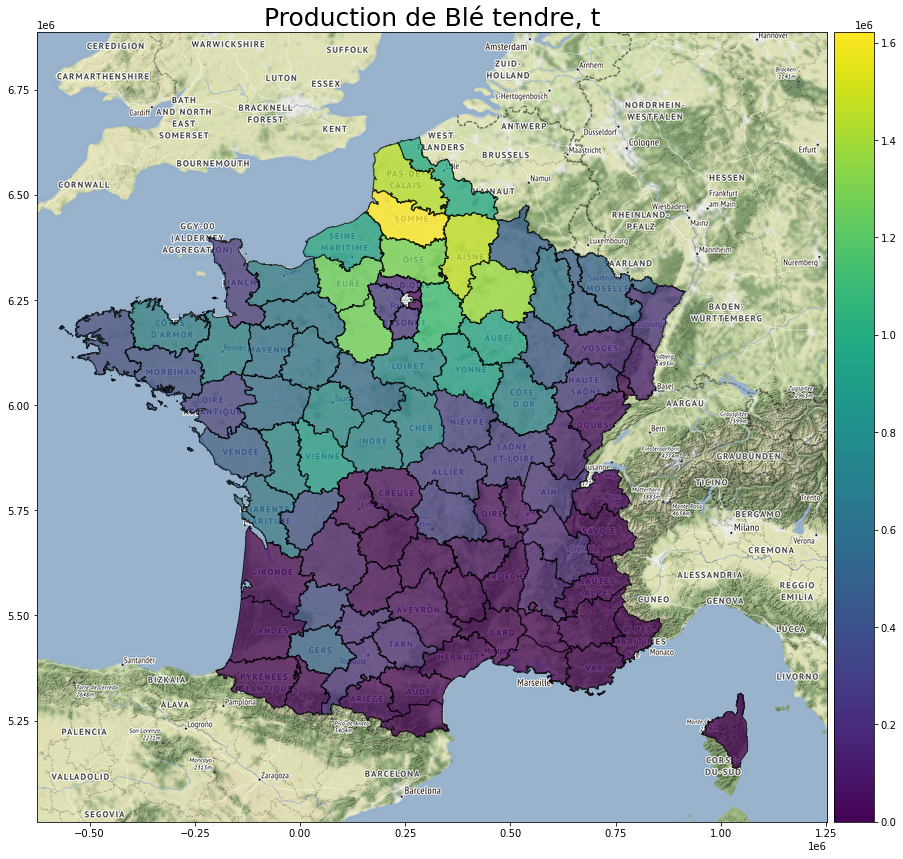

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


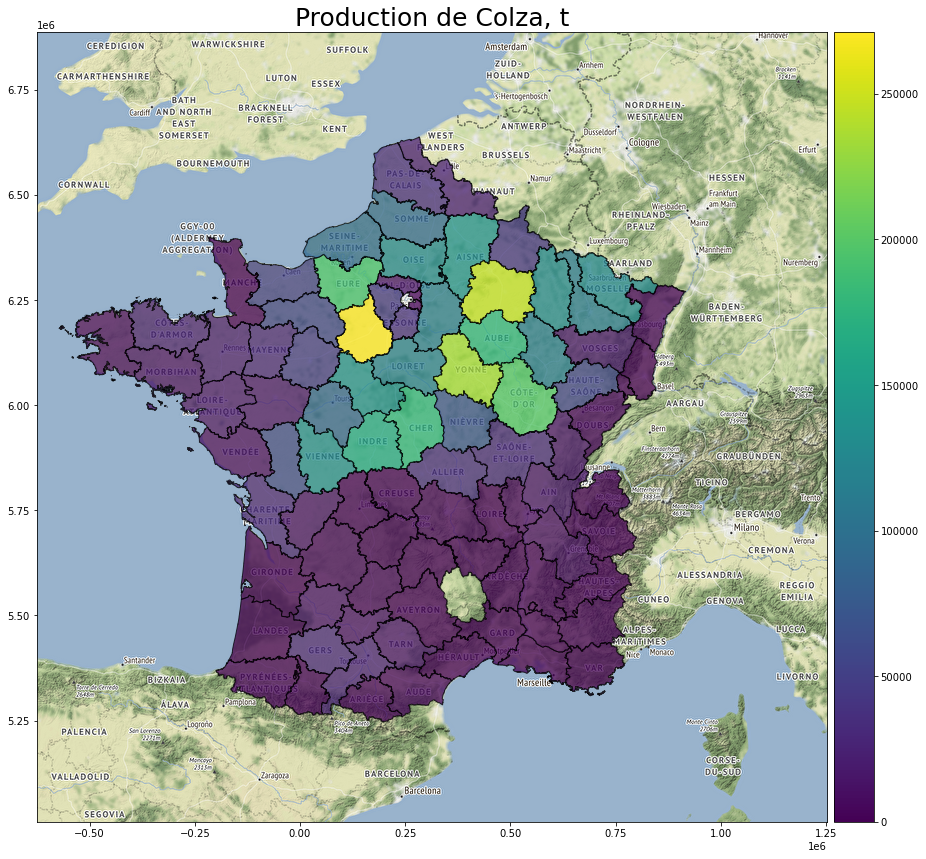

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


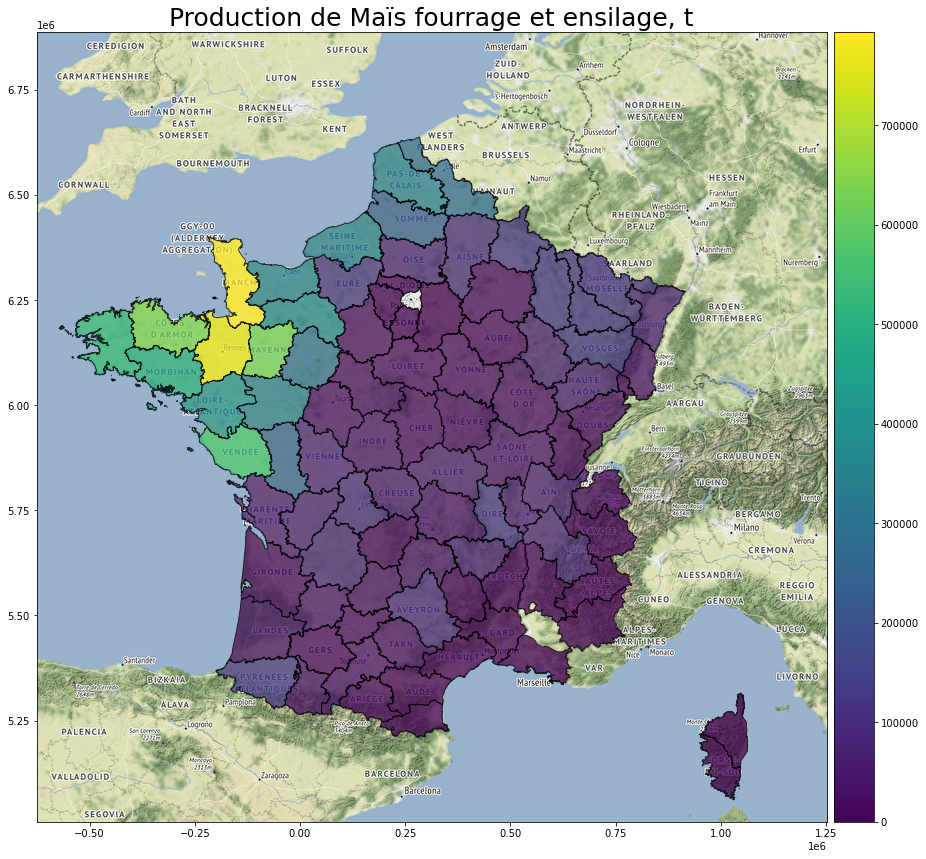

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


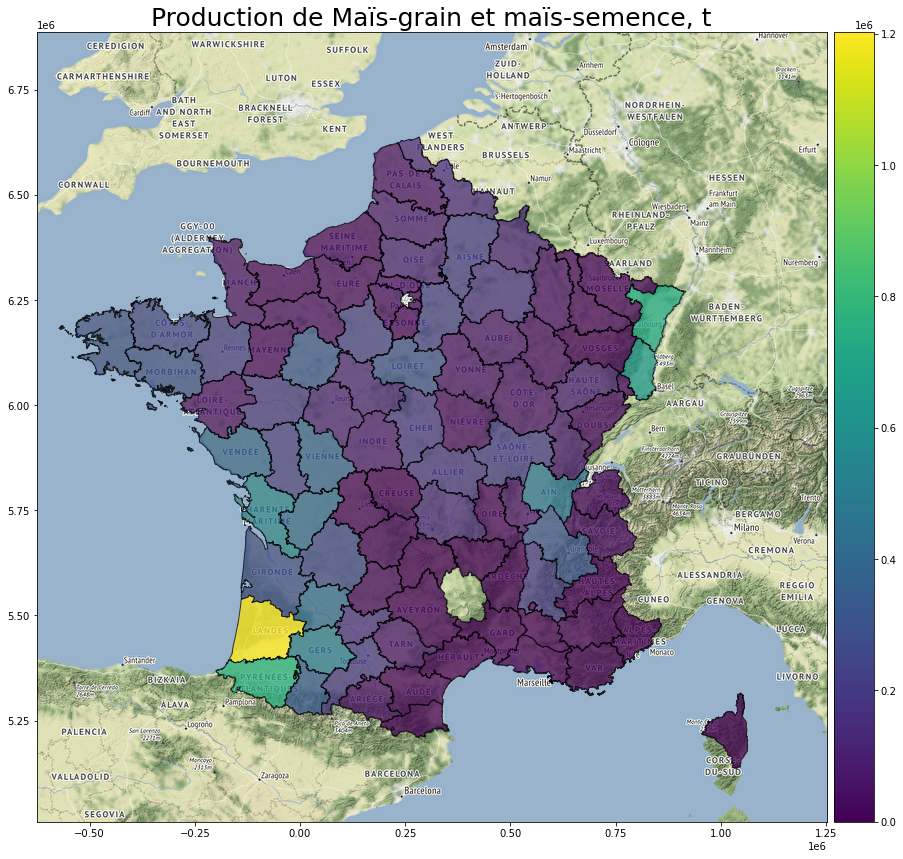

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


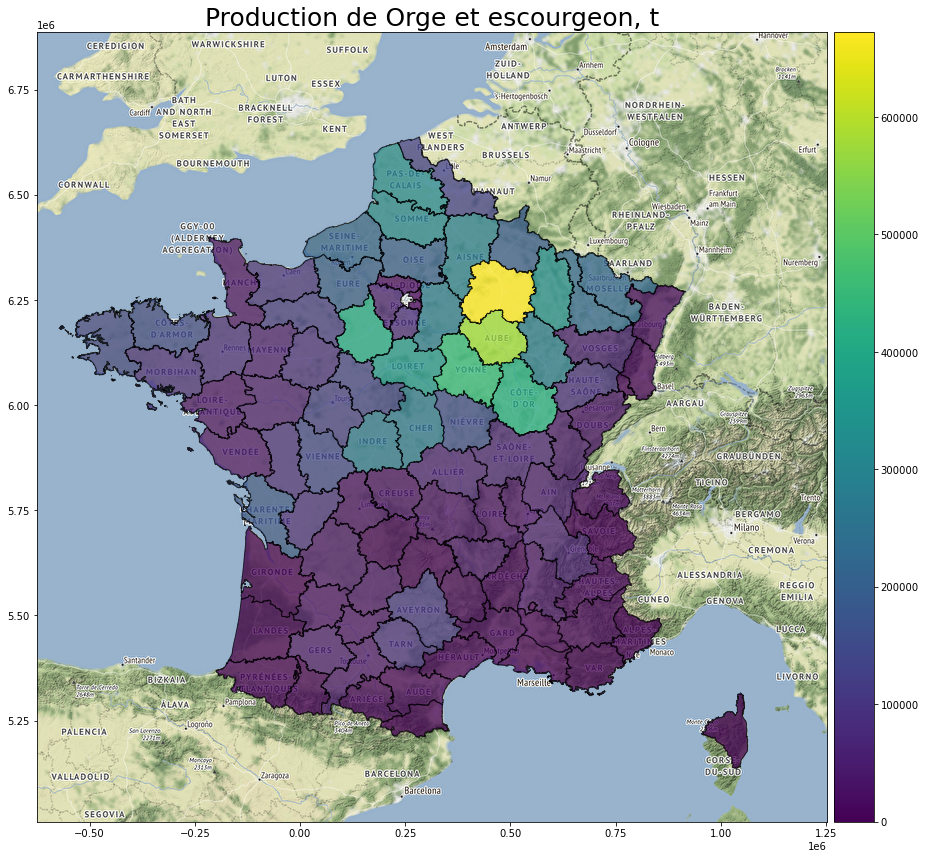

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


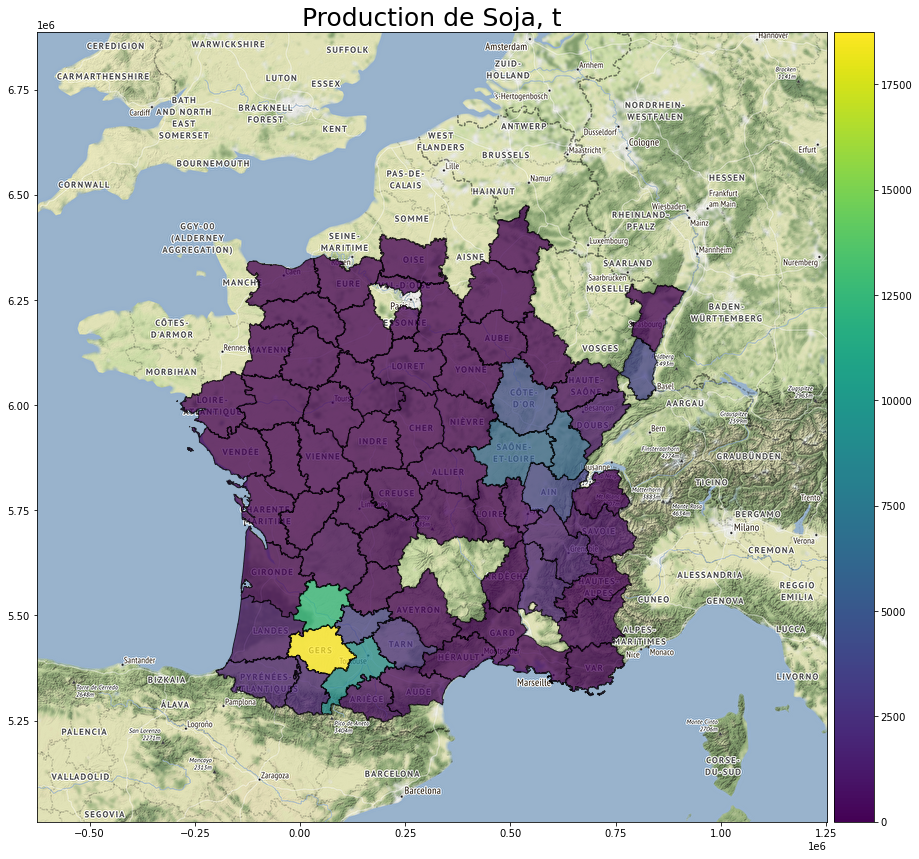

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


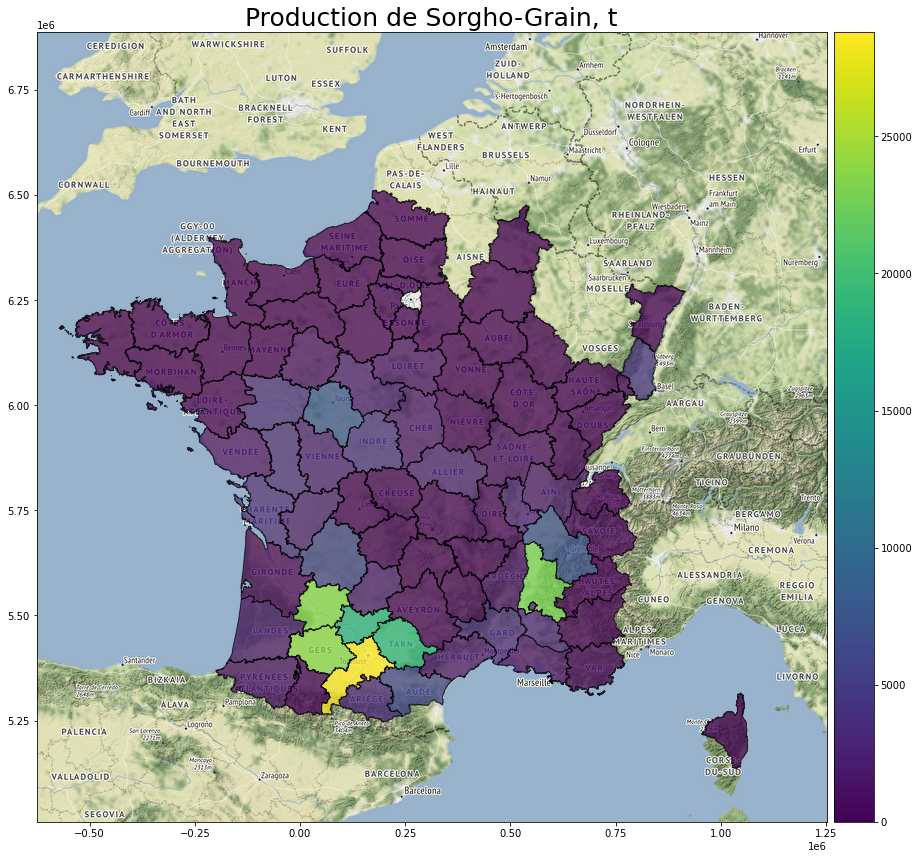

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


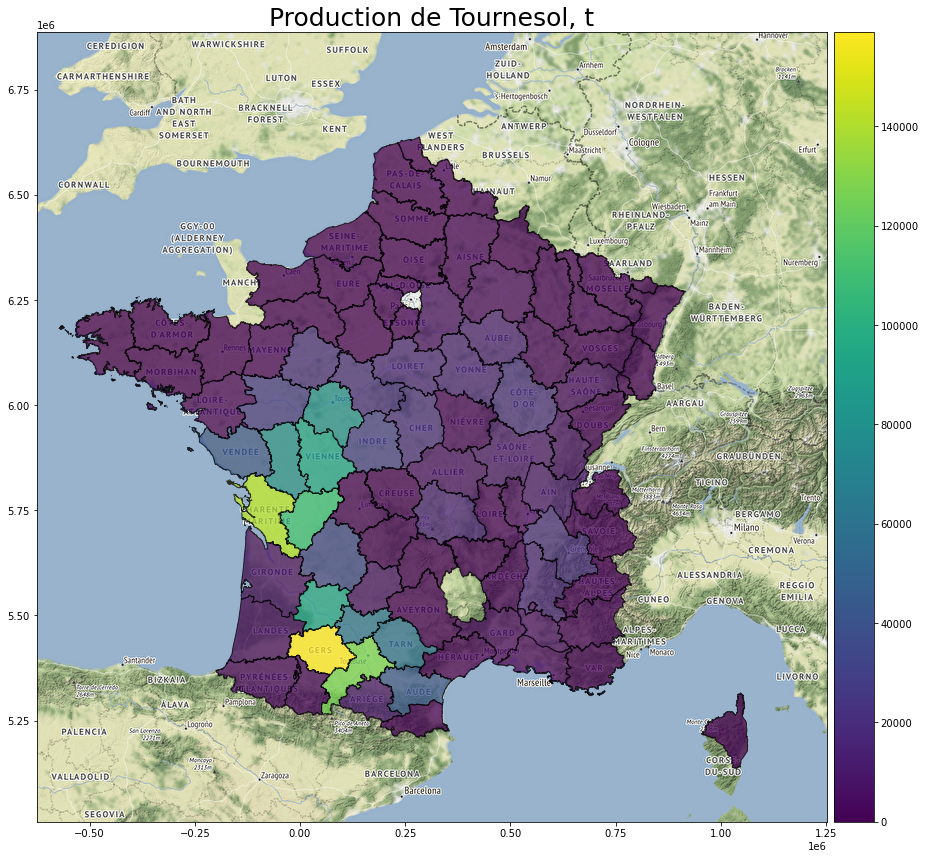

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


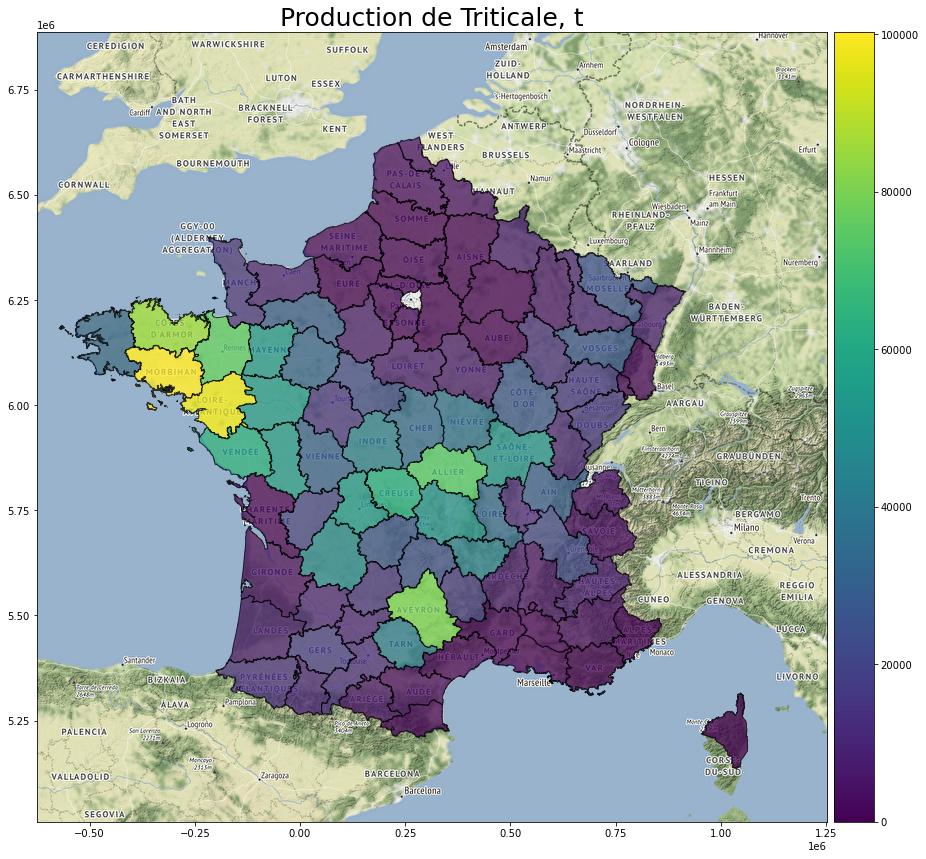

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


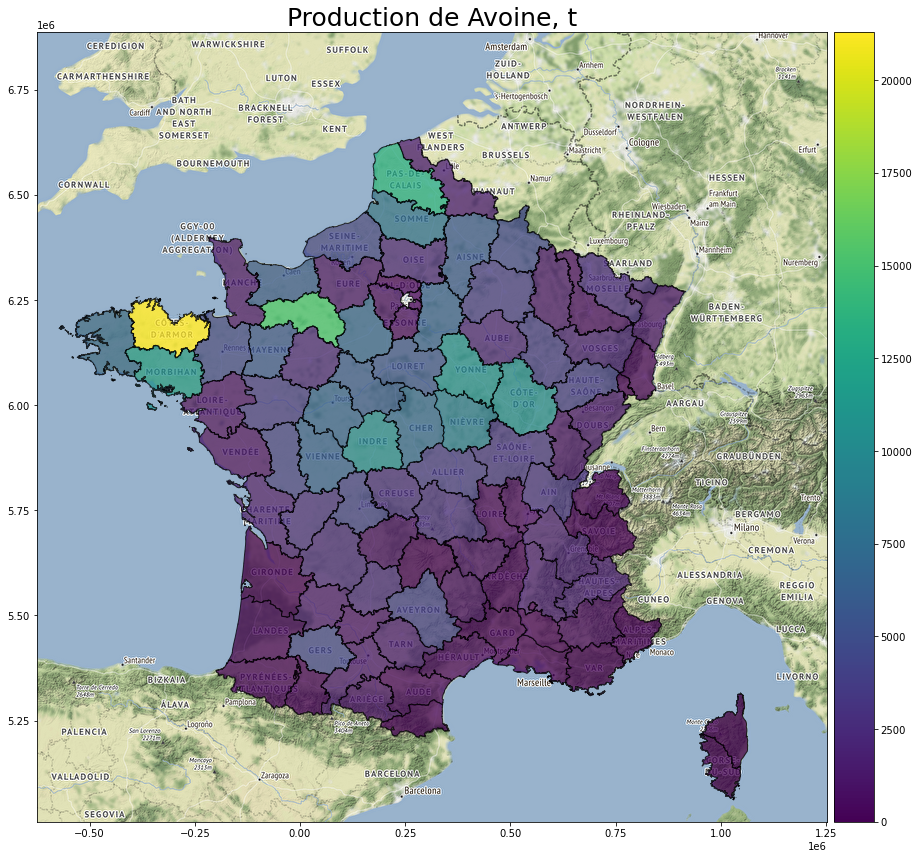

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


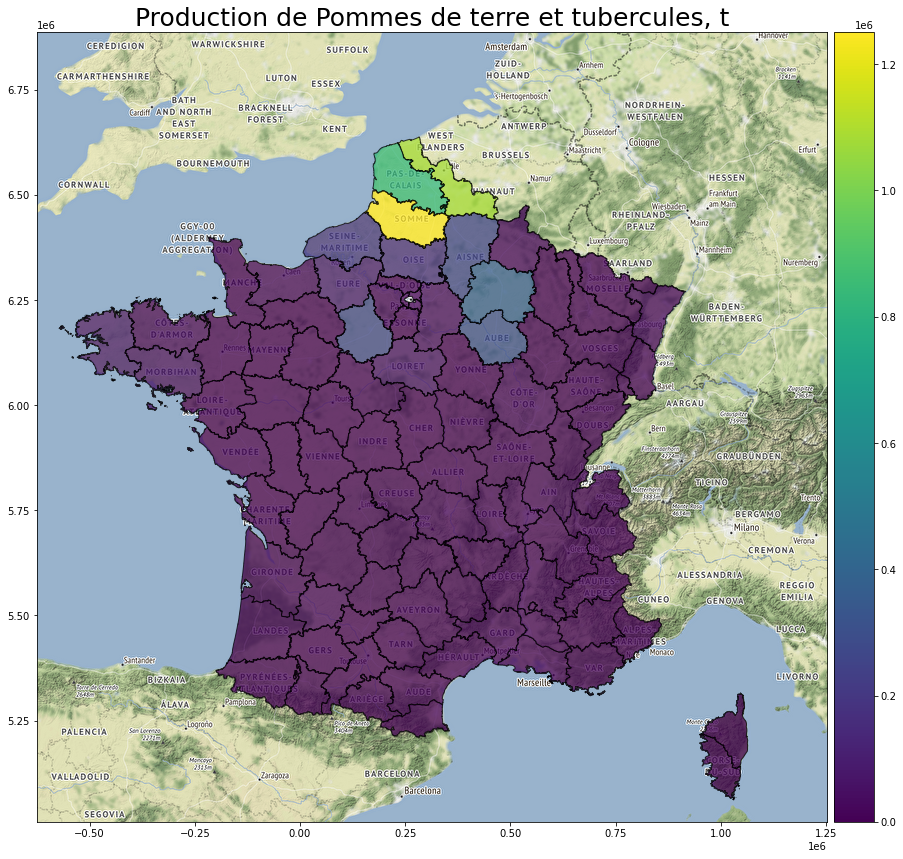

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


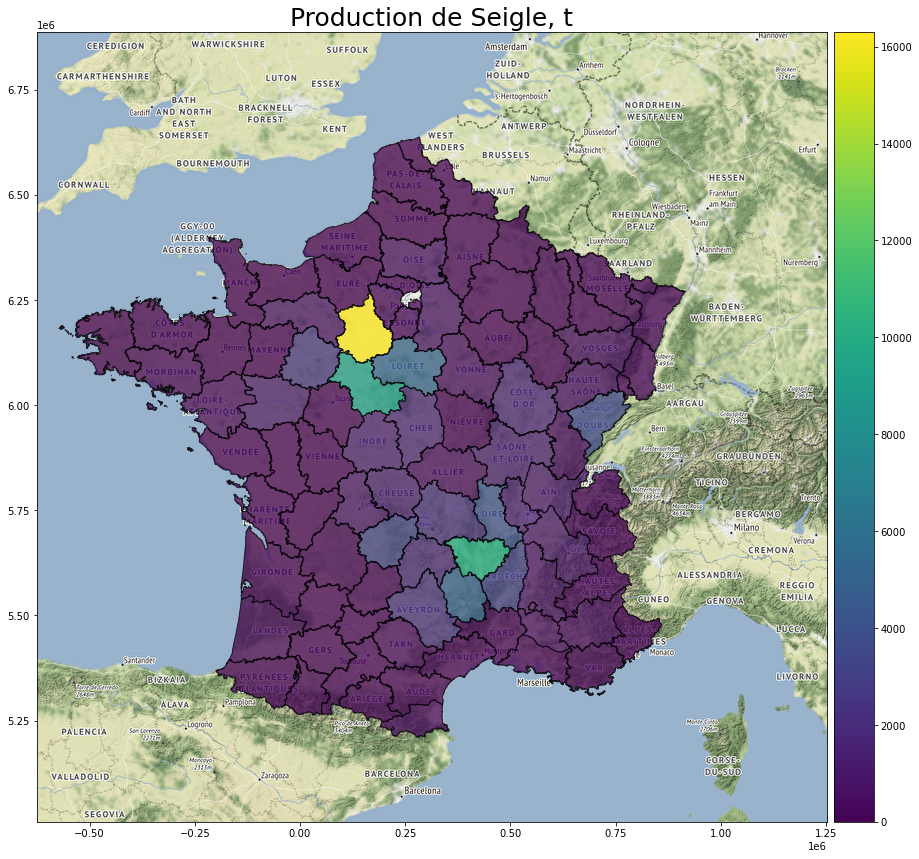

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


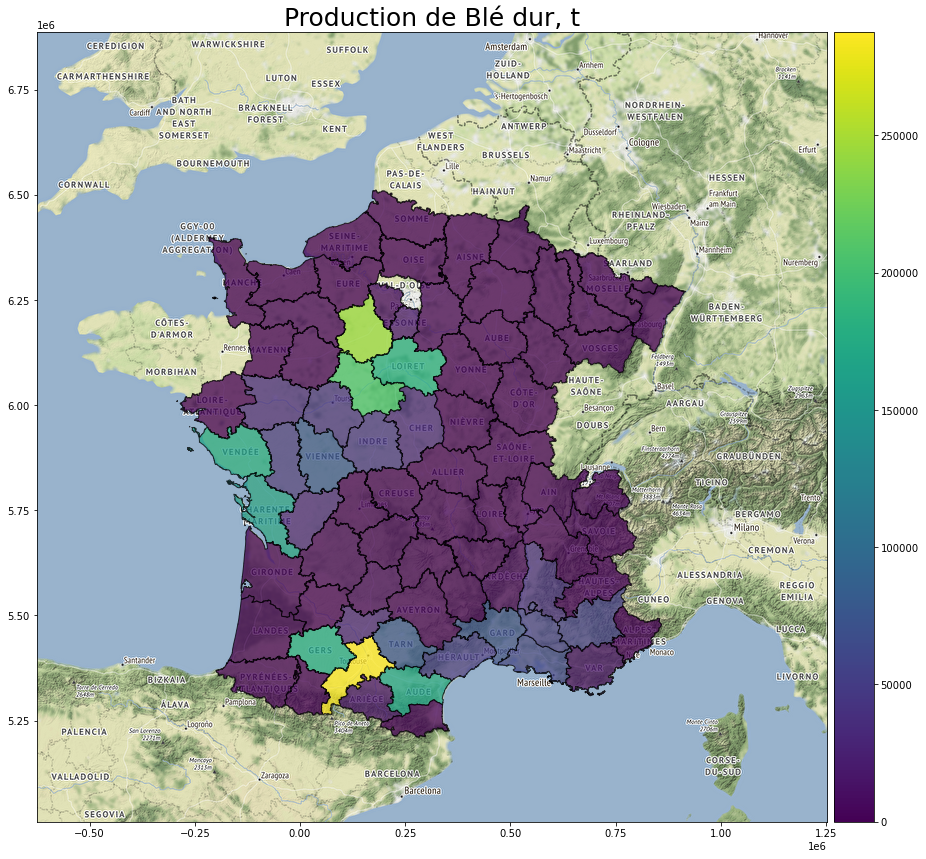

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'crs'. Use 'GeoDataFrame.set_crs(crs, allow_override=True)' to overwrite CRS or 'GeoDataFrame.to_crs(crs)' to reproject geometries. CRS mismatch will raise an error in the future versions of GeoPandas.
  import sys


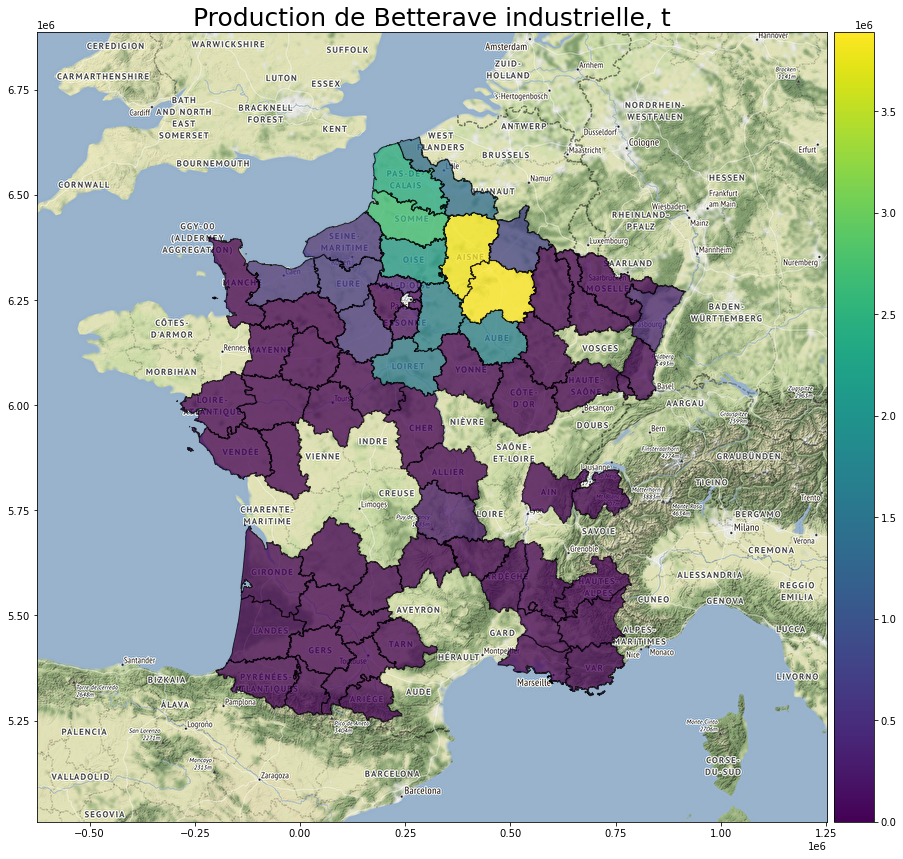

In [63]:
#IMAGE DES PRODUCTIONS
for culture in data.Type_de_culture.unique():
    df = data[data.Type_de_culture == culture][["CANTON_MOD","Production"]]
    df["DEP"] = ""
    for index in df.index.values:
        df.at[index,"DEP"] = df.at[index,"CANTON_MOD"][0:2]
    df = df.groupby(["DEP"],as_index = False).sum()
    df["geometry"]=df["DEP"].map(met)
    vmax = df.Production.max()
    title = "Production de "+culture+", t"
    img_name = "production_"+culture+".png"
    make_img(df, title, img_name, 0, vmax, "Production", True)

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'c

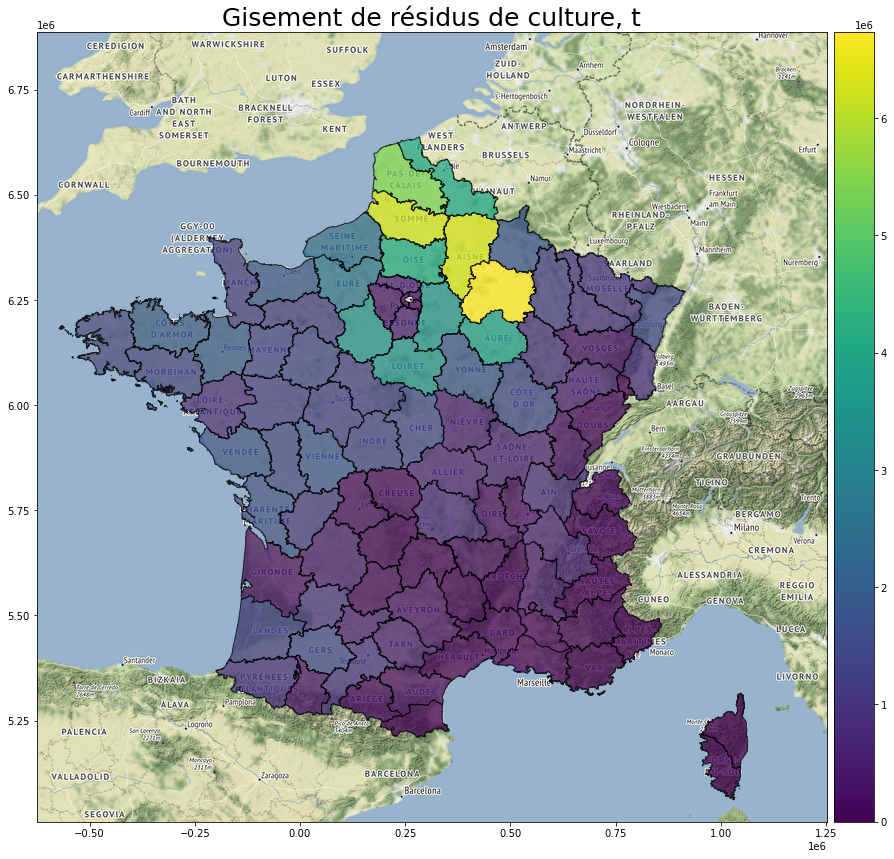

In [57]:
#IMAGE DES RESIDUS DE CULTURE
df = data[["CANTON_MOD","Production"]]
df["DEP"] = ""
for index in df.index.values:
    df.at[index,"DEP"] = df.at[index,"CANTON_MOD"][0:2]
df = df.groupby(["DEP"],as_index = False).sum()
df["geometry"]=df["DEP"].map(met)
vmax = df.Production.max()
title = "Gisement de résidus de culture, t"
img_name = "Gisement_résidus.png"
make_img(df, title, img_name, 0, vmax, "Production", True)

C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\pyproj\crs\crs.py:53: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))
C:\Users\Public\Anaconda3\envs\maps_env\lib\site-packages\ipykernel_launcher.py:7: FutureWarning: CRS mismatch between CRS of the passed geometries and 'c

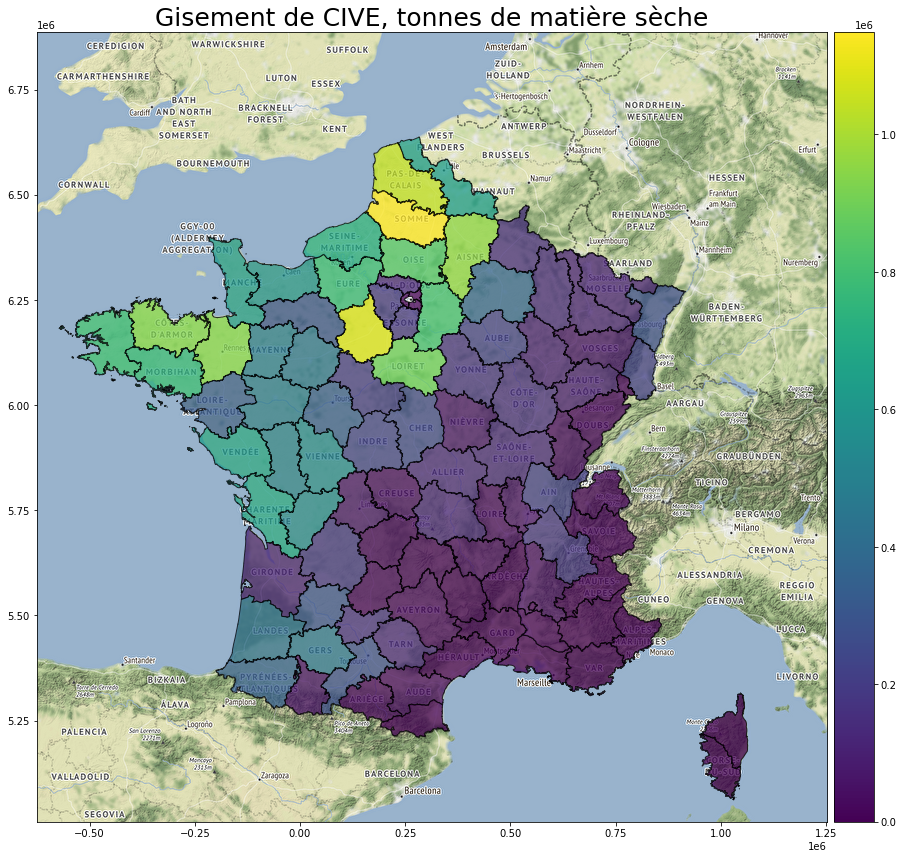

In [115]:
#IMAGE DES CIVE
df = data_civ[["CANTON_MOD","Production"]]
df["DEP"] = ""
for index in df.index.values:
    df.at[index,"DEP"] = df.at[index,"CANTON_MOD"][0:2]
df = df.groupby(["DEP"],as_index = False).sum()
df["geometry"]=df["DEP"].map(met)
vmax = df.Production.max()
title = "Gisement de CIVE, tonnes de matière sèche"
img_name = "Gisement_CIVE.png"
make_img(df, title, img_name, 0, vmax, "Production", True)